## Trying some exploration to see if I can detect some pattern using the following techniques.At the onset of our exploration, I used various filters to investigate whether the bedding planes exhibited a visually distinctive signature in these spaces. My objective was to determine whether it was possible to identify them

In [26]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

In [27]:
image = cv2.imread('/content/_0566_frame1690.jpg',cv2.IMREAD_GRAYSCALE)

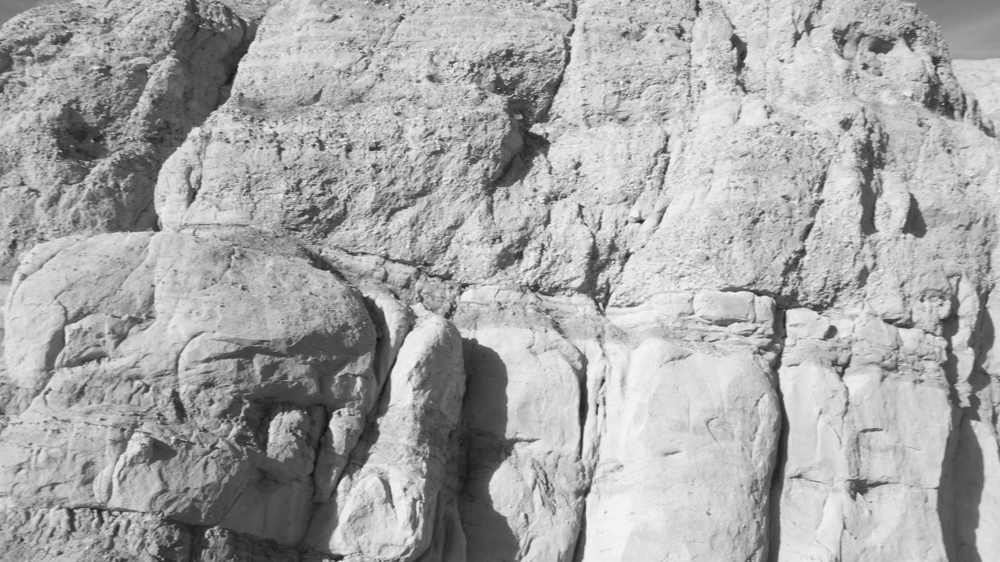

In [6]:
cv2_imshow(image)

A)Equalize histogram (or histogram equalization) is a method used in digital image processing to improve the contrast and brightness of an image. The technique works by redistributing the intensity values of an image so that they are spread more evenly across the entire range of possible values

***Applying this on the actual image***

In [7]:
equ = cv2.equalizeHist(image)

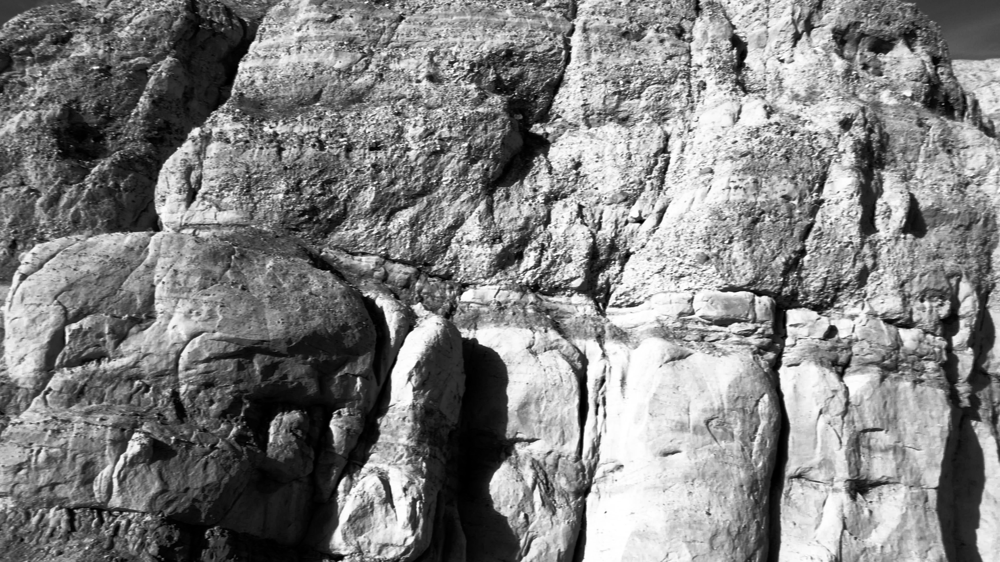

In [8]:
cv2_imshow(equ)

B)Convolve the image with the Gaussian kernel using a convolution operation. 
For each pixel in the image, compute the weighted average of the neighboring pixels using the values in the Gaussian kernel. 
The result is a smoothed version of the original image with reduced noise and sharper edges.

1 2 1

2 4 2

1 2 1

3x3 kernel with values that are symmetric around the center
the resulting pixel value at each position will be the weighted average of the surrounding pixels, with the highest weight given to the center pixel.

***Applying this gaussian blur on the histogram equalised image.*** 

In [20]:
gauss = cv2.GaussianBlur(equ, (5, 5), 0)
# median = cv2.medianBlur(equ, 5)

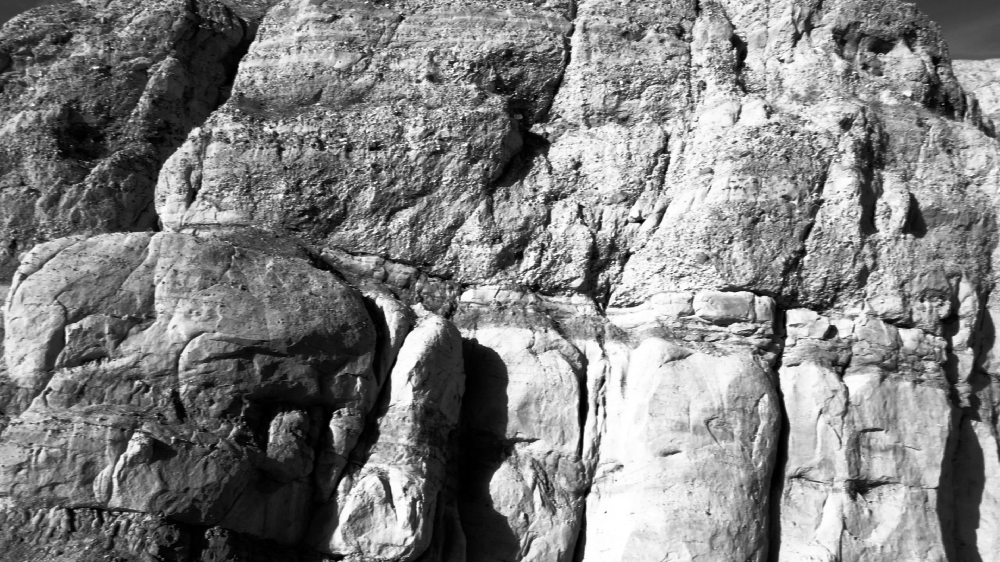

In [12]:
cv2_imshow(gauss)

C)Canny edge detection is a popular image processing technique used to detect the edges of objects in an 

1)After smoothing the image using the Gaussian kernel, we then calculate the intensity gradients. A common method is to use the Sobel Operator

2)Once we have the gradient magnitude and direction, we perform non-maximum suppression

3)Non-maximum suppression works by finding pixels that are local maxima in the direction of the gradient
if, for example, we have three pixels that are next to each other: pixels a, b, and then c. 
Pixel b is larger in intensity than both a and c where pixels a and c are in the gradient direction of b. Therefore, pixel b is marked as an edge

4)Canny Edge Detector goes one step further and applies thresholding to remove the weakest edges and keep the strongest ones. 
Edge pixels that are borderline weak or strong are only considered strong if they are connected to strong edge pixels.

***Applying this canny edge on the image which has been histogram equalised and has been convolved using gaussian kernel***


In [13]:
edges = cv2.Canny(gauss, 100, 200)

and we can see that the bedding layers are still not salient . 

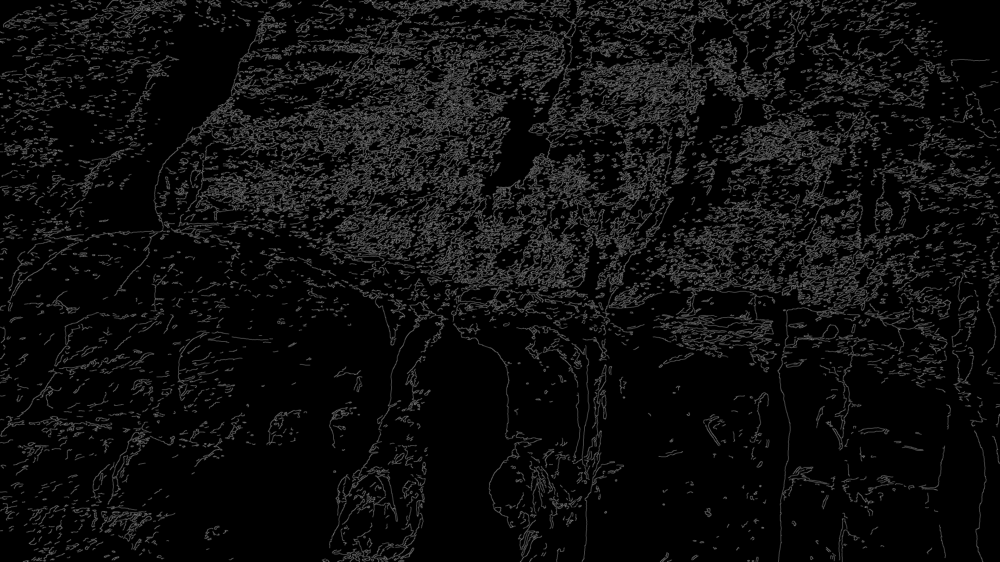

In [14]:
cv2_imshow(edges)

D)Sobel
Used for detecting edges in an image. The basic idea behind the Sobel detector is to compute the gradient of the image, which indicates how rapidly the intensity of the image changes at each point.

The Sobel operator emphasizes edges that have a strong gradient magnitude, while suppressing edges that have a weaker gradient magnitude.

x-direction kernel -   | -1 0 1 |
                       | -2 0 2 |
                       | -1 0 1 |

y-direction kernel -    | -1 -2 -1 |
                        | 0   0  0 |
                        | 1   2  1 |


1)Let gradient approximations in the x-direction be denoted as Gx.Let gradient approximations in the y-direction be denoted as Gy.
2)Gx = x-direction kernel * (3×3 portion of image A with (x,y) as the center cell)

Gy = y-direction kernel * (3×3 portion of image A with (x,y) as the center cell)

3)magnitude(G) = square_root(Gx2 + Gy2)

4)The direction of the gradient Ɵ at pixel (x, y) is:

   Ɵ = atan(Gy / Gx) 

   where Gx and Gy are the horizontal and vertical gradient components at a particular pixel in the image. The arctangent function atan returns the angle between the x-axis and the vector (Gx, Gy), in radians. This angle represents the direction of the gradient at that pixel.

above is just our calculation for a single 3×3 region. We have to do the same thing for the other 3×3 regions in the image. 
And once we have done those calculations, we know that the pixels with the highest magnitude(G) are likely part of an edge.

***Applying sobel on the image which has been histogram equalised and has been convolved using gaussian kernel***

In [15]:

sobelx = cv2.Sobel(gauss, cv2.CV_64F, 1, 0, ksize=5)
sobely = cv2.Sobel(gauss, cv2.CV_64F, 0, 1, ksize=5)

# Combining the results of Sobel in x and y direction
sobel = cv2.addWeighted(sobelx, 0.5, sobely, 0.5, 0)

and we can see that the bedding layers still can't be differntiated from the other edges

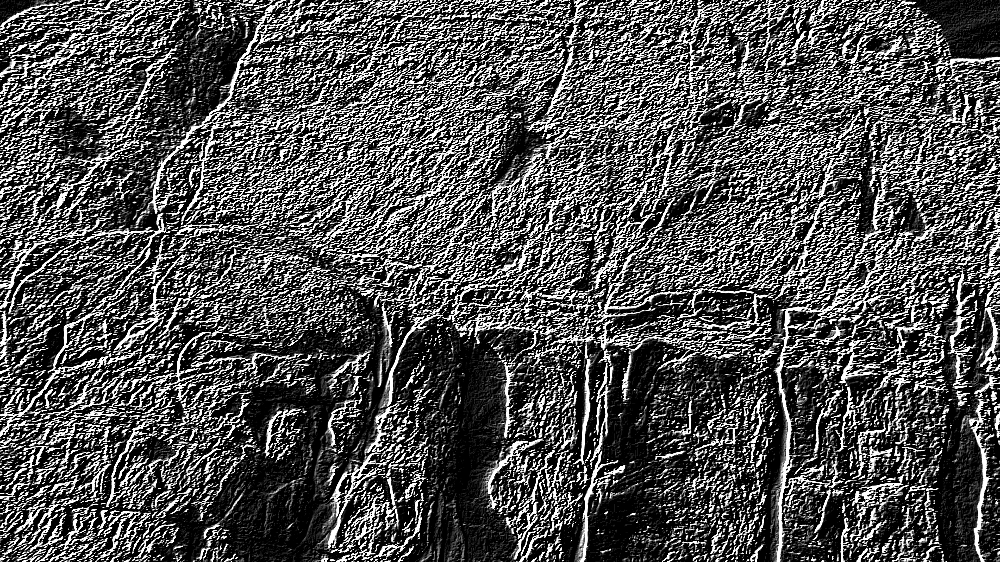

In [16]:
cv2_imshow(sobel)

E)Schaar
It is similar to other edge detection filters such as the Sobel etc, but is more rotationally symmetric and can produce more accurate edge detection results for images with edges at different angles.

The Schaar operator also uses two 3x3 convolution kernels, one for the horizontal direction and one for the vertical direction, but with different values than the Sobel operator.

***Applying schaar on the image which has been histogram equalised and has been convolved using gaussian kernel***

And again the detection is still not good enough

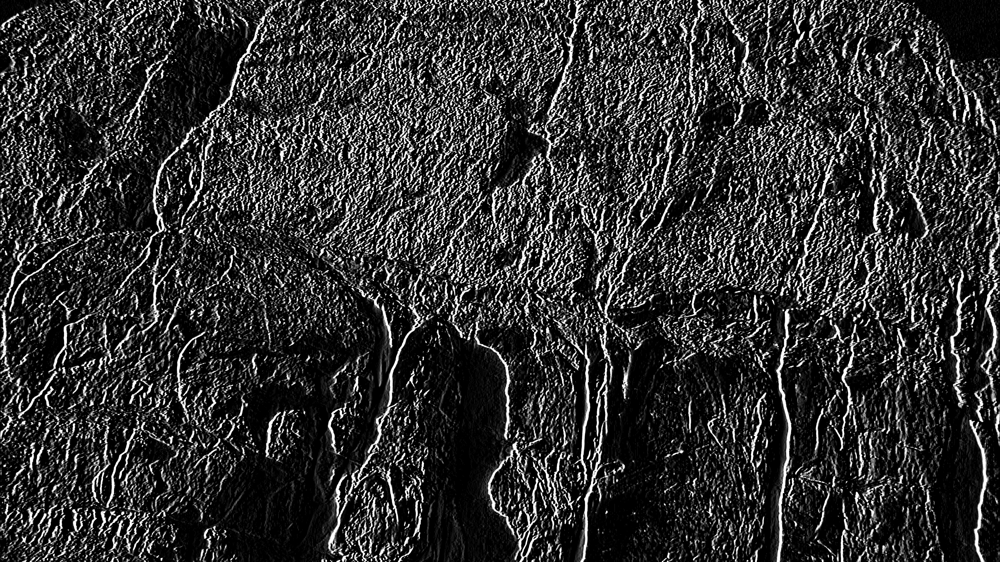

In [21]:
edges2 = cv2.Scharr(gauss, cv2.CV_8U, 1, 0)
cv2_imshow(edges2)

F)Dilation followed by erosion (known as opening) can be used to remove small objects or noise while preserving the shape and size of larger objects.

Dilation is an operation that expands the boundaries of bright regions and shrinks the boundaries of dark regions in an image

Erosion is an operation that shrinks the boundaries of bright regions and expands the boundaries of dark regions in an image

***Applying dialation and erosion on the sobel image*** 

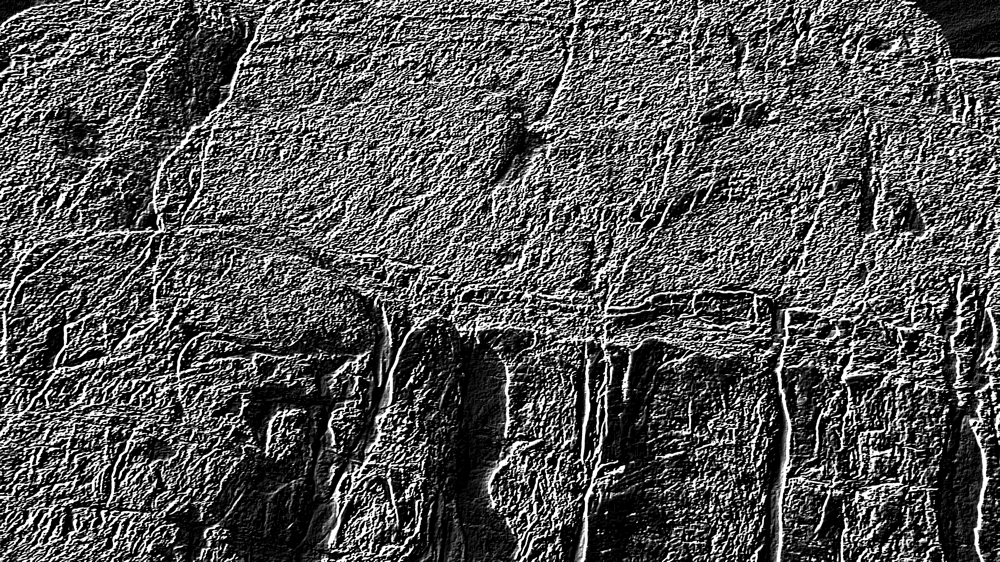

In [22]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))

# Apply dilation and erosion
dilated = cv2.dilate(sobel, kernel, iterations=1)
eroded = cv2.erode(dilated, kernel, iterations=1)

cv2_imshow(eroded)

G)**Hough Trans** - The basic idea behind the Hough Transform is to represent a geometric shape (such as a line) in a parameter space rather than in the image space. For example, a line can be represented by its slope and intercept in the Cartesian coordinate system, or by its polar coordinates (distance from the origin and angle with respect to the x-axis) in the Hough parameter space. Each point in the image that lies on the line corresponds to a sinusoidal curve in the Hough space, and the intersection of these curves indicates the parameters of the line.

the Hough transform algorithm is based on the idea of representing lines in an image as points in a parameter space, and then searching for peaks in the accumulator array to identify the most likely lines. The algorithm can be generalized to detect other shapes by adapting the parameterization and accumulator array accordingly.

1)For each edge point in the image, compute the values of r and θ that represent all possible lines that pass through that point. 
r is the distance from the origin to the closest point on the line, and θ is the angle between the line and the x-axis.

2) increment the accumulator array at the corresponding (r,θ) cell for each edge point

3) Once all edge points have been processed, the accumulator array will contain peaks that represent the most likely lines in the image. These peaks correspond to the cells with the highest values in the accumulator array.


for a circle ( A circle can be represented by its center coordinates (x,y) and its radius r)


Line detection, Circle detection,Ellipse detection,Shape recognition

***Here my idea was to to use the Hough lines to detect the Bedding layer edges as it could be thought of as edeges made of several small striaghtlines.*** 

***The HoughTransform was applied on the eroded image***

In [24]:
eroded2 = np.uint8(eroded)
lines = cv2.HoughLines(eroded2, 1, np.pi/180, 50)

# Draw the detected lines on the original image
for line in lines:
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a * rho
    y0 = b * rho
    x1 = int(x0 + 1000*(-b))
    y1 = int(y0 + 1000*(a))
    x2 = int(x0 - 1000*(-b))
    y2 = int(y0 - 1000*(a))
    cv2.line(image, (x1, y1), (x2, y2), (0, 0, 255), 2)

As we can see the edge lines didnot get detected.

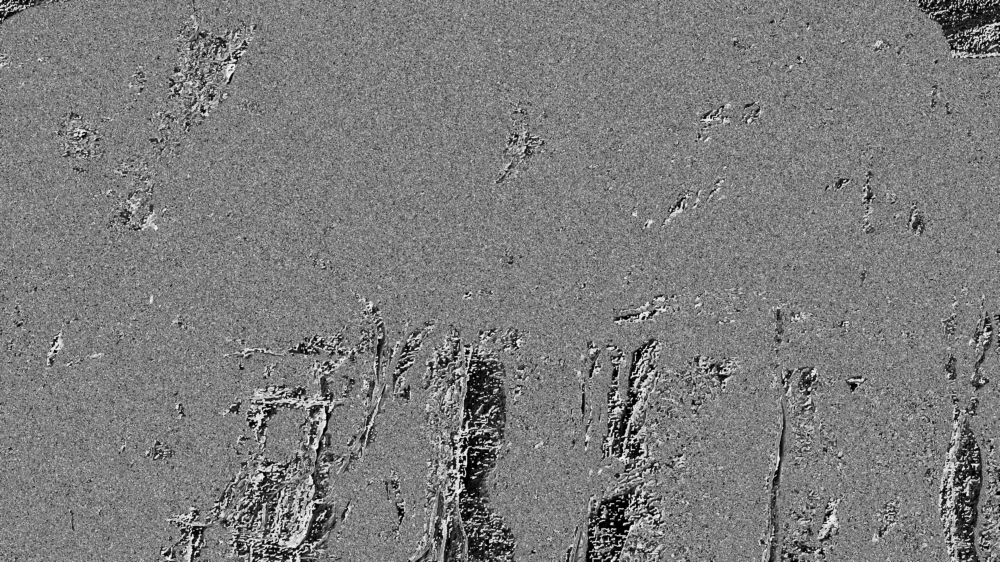

In [25]:
cv2_imshow(eroded2)

H) **LBP** - The basic idea behind LBP is to compare the intensity of a central pixel with its neighboring pixels within a circular region of a certain radius. 

For each neighbor, a binary value of 1 is assigned if its intensity is greater than or equal to the central pixel's intensity, and a value of 0 is assigned otherwise.

These binary values are then concatenated into a binary pattern that represents the local texture around the central pixel.

This process is repeated for every pixel in the image, resulting in a LBP image that captures the local texture patterns at each pixel location.

Here's a step-by-step explanation of the LBP algorithm (assuimg the input iamge is already gray scaled):

1) Divide the image into non-overlapping cells

Assume we have the following 6x6 grayscale image

140 145 150 160 165 170

135 140 145 155 160 165

130 135 140 150 155 160

120 125 130 140 145 150

115 120 125 135 140 145

110 115 120 130 135 140

Divide the image into non-overlapping cells (2x2 cells in our example):

Cell 1:

140 145 150

135 140 145

Cell 2:

160 165 170

155 160 165

Cell 3:

130 135 140

115 120 125

Cell 4:

150 155 160

140 145 150

2)Apply the LBP operator to each pixel within a cell and calculate the LBP code:-  For each pixel in the cell, compare its intensity value with its 6 neighboring pixels in a 2x2 neighborhood. If the center pixel's intensity is less than or equal to its neighbor, assign the neighbor a value of 0; otherwise, assign it a value of 1.

showimg only for cell 1 

1 1 1

1 x 1  ->  "11111111" -> 255 (center pixel = 140)

1 1 1

x 1 1  ->  "11111110" -> 254 (center pixel = 145)

1 x 1

1 1 1  ->  "11111000" -> 248 (center pixel = 150)

1 1 1

1 1 x  ->  "11111111" -> 255 (center pixel = 145)

3) Create a histogram of LBP codes for each cell:

Cell 1 histogram: [0, 0, 0, ..., 1, 1, 2] (One 248, one 254, and two 255)

Repeat steps 2 and 3 for the other cells.

6) Repeat steps 3-5 for the other cells.

For our example, let's assume we have the following histograms for the cells:

Cell 1: [0, 0, 0, ..., 1, 1, 2]

Cell 2: [0, 0, 0, ..., 1, 1, 1]

Cell 3: [0, 0, 0, ..., 1, 2, 1]

Cell 4: [0, 0, 0, ..., 1, 1, 3]

Concatenate them into a single feature vector:

[0, 0, 0, ..., 1, 1, 2, 0, 0, 0, ..., 1, 1, 1, 0, 0, 0, ..., 1, 2, 1, 0, 0, 0, ..., 1, 1, 3]


 This feature vector represents the texture information of the region.








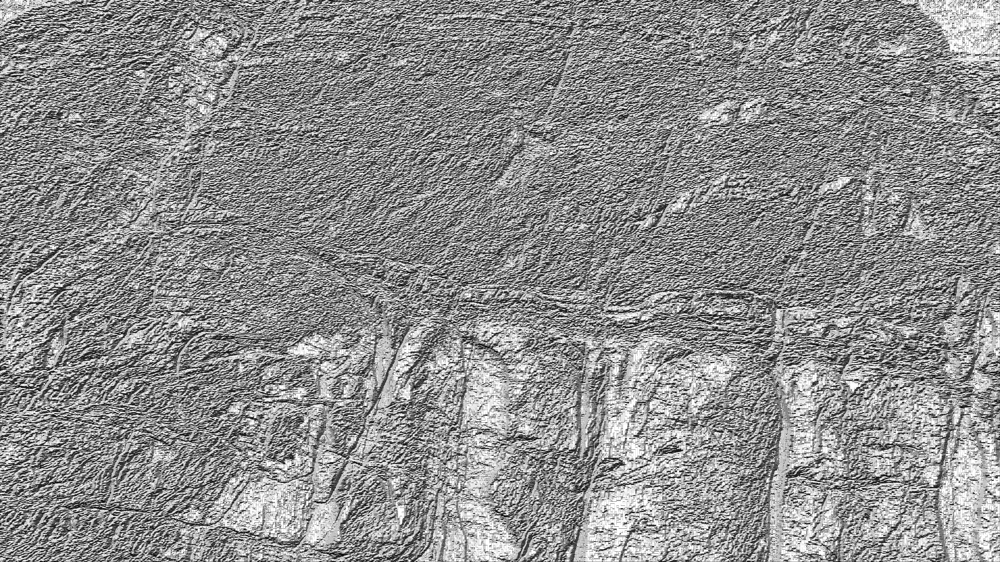

In [29]:
import cv2
import numpy as np
from skimage import feature

n_points=8
radius=1

lbp_image = feature.local_binary_pattern(image, n_points, radius, method='default')

cv2_imshow(lbp_image.astype('uint8'))



## As we can see the result were clearly not satifactory , so now i will move to advance modelling